In [111]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from funpymodeling.exploratory import freq_tbl 
import re
from turtle import color

In [112]:
dfp=pd.read_csv("listings.csv")
dfa=pd.read_csv("listings_amsterdam.csv")

***AMSTERDAM***

In [113]:
dfa.head(5)
dfa.dtypes

id                                                int64
listing_url                                      object
scrape_id                                         int64
last_scraped                                     object
source                                           object
name                                             object
description                                      object
neighborhood_overview                            object
picture_url                                      object
host_id                                           int64
host_url                                         object
host_name                                        object
host_since                                       object
host_location                                    object
host_about                                       object
host_response_time                               object
host_response_rate                               object
host_acceptance_rate                            

In [114]:
#Se eliminan los valores nulos
dfa.isnull().sum()
dfa=dfa.fillna(method='ffill')
dfa=dfa.fillna(method='bfill')

C:\Users\Rene Vazquez\AppData\Local\Temp\ipykernel_11196\1736785499.py:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  dfa=dfa.fillna(method='ffill')
C:\Users\Rene Vazquez\AppData\Local\Temp\ipykernel_11196\1736785499.py:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  dfa=dfa.fillna(method='bfill')


In [115]:
#Como no funciono el bfill y ffill usamos el metodo de sustituir por una palabra 
dfa1=dfa.fillna('nulos')
dfa1.info()
dfa1.isnull().sum().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9310 entries, 0 to 9309
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            9310 non-null   int64  
 1   listing_url                                   9310 non-null   object 
 2   scrape_id                                     9310 non-null   int64  
 3   last_scraped                                  9310 non-null   object 
 4   source                                        9310 non-null   object 
 5   name                                          9310 non-null   object 
 6   description                                   9310 non-null   object 
 7   neighborhood_overview                         9310 non-null   object 
 8   picture_url                                   9310 non-null   object 
 9   host_id                                       9310 non-null   i

0

In [116]:
#Reemplazamos el $ en la columna price para que se vuelva numerica 
dfa1['price'] = dfa1['price'].str.replace('$', '', regex=False)
dfa1['price'] = dfa1['price'].str.replace(',', '', regex=False)
dfa1['price'] = pd.to_numeric(dfa1['price'])

In [117]:
dfa1['price']

0         200.0
1         200.0
2         155.0
3         155.0
4         155.0
5        1600.0
6         125.0
7         125.0
8          82.0
9         155.0
10         79.0
11         59.0
12         59.0
13        269.0
14        321.0
15        475.0
16        130.0
17        146.0
18        146.0
19        146.0
20        149.0
21        200.0
22        200.0
23        181.0
24         85.0
25        350.0
26        350.0
27        300.0
28        300.0
29        300.0
30        445.0
31         97.0
32        260.0
33        260.0
34        163.0
35        163.0
36        163.0
37        115.0
38        299.0
39        299.0
40        779.0
41        132.0
42        440.0
43        440.0
44        186.0
45        450.0
46        450.0
47        450.0
48        979.0
49        184.0
50        185.0
51        125.0
52        141.0
53        141.0
54        264.0
55        275.0
56        128.0
57        245.0
58        228.0
59        173.0
60        529.0
61        188.0
62      

In [118]:
#Se separan las columnas por cualitativas y cuantitativas
numcol=dfa1.select_dtypes(include=['number'])
catcolsinfiltrar=dfa1.select_dtypes(include=['object'])

In [119]:
#Se seleccionan las variables solicitadas 
catcol=catcolsinfiltrar[['host_response_time','host_acceptance_rate','property_type','room_type','amenities','host_is_superhost']]

In [120]:
#Se procesan los datos nulos de las varibales numericas 
numcol.isnull().sum().sum()
numcol=numcol.fillna(method='ffill')
numcol=numcol.fillna(method='bfill')

C:\Users\Rene Vazquez\AppData\Local\Temp\ipykernel_11196\3788119204.py:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  numcol=numcol.fillna(method='ffill')
C:\Users\Rene Vazquez\AppData\Local\Temp\ipykernel_11196\3788119204.py:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  numcol=numcol.fillna(method='bfill')


In [121]:
#Comprobamos los valores faltantes nuevamente 
numcol.isnull().sum().sum()

0

In [122]:
numcol_sinid=numcol.drop(['id','host_id','scrape_id'],axis=1)

<Figure size 1500x800 with 0 Axes>

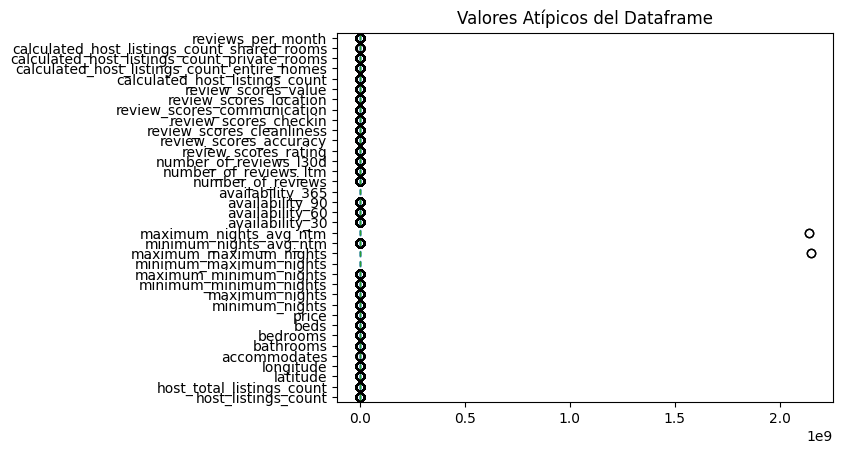

In [123]:
#Obtenemos los limites superior e inferior de todas las variables numericas
#Realizamos diagrama de caja o bigote de cada columna del dataframe
fig = plt.figure(figsize =(15, 8))
numcol_sinid.plot(kind='box', vert=False)
plt.title("Valores Atípicos del Dataframe")
plt.show() 

In [124]:
#Método aplicando desviación estandar. Encuentro los valores extremos
y=numcol_sinid
Limite_Superior= y.mean() + 3*y.std()
Limite_Inferior= y.mean() - 3*y.std()
print("Limite superior permitido", Limite_Superior)
print("Limite inferior permitido", Limite_Inferior)

Limite superior permitido host_listings_count                             9.885468e+01
host_total_listings_count                       1.501162e+02
latitude                                        5.241881e+01
longitude                                       4.996959e+00
accommodates                                    7.033283e+00
bathrooms                                       3.032154e+00
bedrooms                                        4.320208e+00
beds                                            6.527505e+00
price                                           3.201865e+03
minimum_nights                                  6.270322e+01
maximum_nights                                  1.623461e+03
minimum_minimum_nights                          5.801519e+01
maximum_minimum_nights                          6.342350e+01
minimum_maximum_nights                          1.837076e+03
maximum_maximum_nights                          9.488261e+07
minimum_nights_avg_ntm                          6.230631e+0

In [125]:
#Obtenemos datos y los outliers se convierten en nulos en el DataFrame
numcol_outliers= numcol_sinid[(y<=Limite_Superior)&(y>=Limite_Inferior)]
numcol_outliers

,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,3.0,3.0,52.359310,4.898440,4.0,1.5,2.0,2.0,200.0,4.0,...,4.63,4.84,4.88,4.91,4.66,3.0,2.0,1.0,0.0,0.22
1,2.0,2.0,52.391850,4.886900,NaN,1.5,NaN,2.0,200.0,2.0,...,4.69,4.86,4.88,4.58,4.48,2.0,2.0,0.0,0.0,0.72
2,3.0,3.0,52.358710,4.896160,2.0,1.0,1.0,0.0,155.0,3.0,...,5.00,5.00,5.00,5.00,5.00,3.0,2.0,1.0,0.0,0.04
3,3.0,3.0,52.359720,4.897500,2.0,1.0,1.0,0.0,155.0,3.0,...,4.69,4.94,4.92,4.92,4.64,3.0,2.0,1.0,0.0,0.29
4,1.0,1.0,52.371040,4.877130,2.0,1.0,1.0,0.0,155.0,5.0,...,4.81,4.90,4.92,4.94,4.61,1.0,1.0,0.0,0.0,0.63
5,2.0,2.0,52.368660,4.920710,NaN,2.5,NaN,NaN,1600.0,2.0,...,4.65,4.90,4.91,4.52,4.55,2.0,2.0,0.0,0.0,0.99
6,1.0,3.0,52.356590,4.908270,2.0,1.0,1.0,1.0,125.0,2.0,...,4.99,4.95,4.95,4.88,4.83,1.0,0.0,1.0,0.0,2.07
7,1.0,3.0,52.382950,4.887260,2.0,1.0,1.0,1.0,125.0,5.0,...,4.61,4.91,4.91,4.91,4.56,1.0,1.0,0.0,0.0,0.65
8,1.0,1.0,52.364350,4.943580,2.0,1.5,1.0,2.0,82.0,3.0,...,4.99,4.96,4.98,4.72,4.80,1.0,0.0,1.0,0.0,2.04
9,1.0,1.0,52.387610,4.891880,2.0,1.5,1.0,1.0,155.0,3.0,...,4.94,4.95,4.92,4.89,4.78,1.0,0.0,1.0,0.0,1.80


In [126]:
#Comprobamos los valores atipicos que se volvieron nulos 
numcol_outliers.isnull().sum()

host_listings_count                              32
host_total_listings_count                        32
latitude                                        131
longitude                                       114
accommodates                                     79
bathrooms                                        95
bedrooms                                         71
beds                                             59
price                                             5
minimum_nights                                   41
maximum_nights                                    0
minimum_minimum_nights                           32
maximum_minimum_nights                           40
minimum_maximum_nights                            0
maximum_maximum_nights                            2
minimum_nights_avg_ntm                           40
maximum_nights_avg_ntm                            2
availability_30                                 318
availability_60                                  76
availability

In [ ]:
#Reemplazamos valores atípicos (nulos) del dataframe con "mean"
#Realizamos una copia del dataframe
numcol_clean=numcol_outliers.copy()
numcol_clean=numcol_clean.fillna(round(numcol_outliers.mean(),1))
numcol_clean

In [128]:
#Corroboramos valores nulos del dataframe LIMPIO
numcol_clean.isnull().sum().sum()

0

In [129]:
freq_tbl(catcol)
catcol.columns

   host_response_time  frequency  percentage  cumulative_perc
0      within an hour       4753    0.510526         0.510526
1  within a few hours       2413    0.259184         0.769710
2        within a day       1835    0.197100         0.966810
3  a few days or more        309    0.033190         1.000000

----------------------------------------------------------------

   host_acceptance_rate  frequency  percentage  cumulative_perc
0                  100%       3133    0.336520         0.336520
1                    0%        455    0.048872         0.385392
2                   50%        397    0.042642         0.428034
3                   99%        377    0.040494         0.468528
4                   67%        282    0.030290         0.498818
5                   98%        252    0.027068         0.525886
6                   75%        235    0.025242         0.551128
7                   80%        196    0.021053         0.572180
8                   33%        187    0.020086 

Index(['host_response_time', 'host_acceptance_rate', 'property_type',
       'room_type', 'amenities', 'host_is_superhost'],
      dtype='object')

In [130]:
# Limitar numero máximo de filas
pd.options.display.max_rows = None

In [131]:
#Obtenemos un análisis univariado de las diferentes variables
table1= freq_tbl(catcol['amenities'])
table2= freq_tbl(catcol['host_acceptance_rate'])
table3= freq_tbl(catcol['host_is_superhost'])
table4= freq_tbl(catcol['host_response_time'])
table5= freq_tbl(catcol['property_type'])
table6= freq_tbl(catcol['room_type'])
table1
table2
table3
table4
table5
table6

,room_type,frequency,percentage,cumulative_perc
0,Entire home/apt,7436,0.798711,0.798711
1,Private room,1783,0.191515,0.990226
2,Hotel room,49,0.005263,0.995489
3,Shared room,42,0.004511,1.000000


In [132]:
#table1['amenities']=table1['amenities'].str.replace(r"\u2013", '')


In [133]:
#Analizar categorias de una columna
df6 = table1.groupby(['amenities'])['amenities'].count()
df6

amenities
["40 inch HDTV with Chromecast", "Baking sheet", "Wine glasses", "Shampoo", "EV charger", "Lockbox", "Hot water kettle", "Extra pillows and blankets", "Shower gel", "Hangers", "Body soap", "Lake access", "Private patio or balcony", "Dedicated workspace", "Fast wifi \u2013 53 Mbps", "Cleaning products", "Room-darkening shades", "First aid kit", "Pocket wifi", "Self check-in", "Central heating", "Bed linens", "Conditioner", "Microwave", "Drying rack for clothing", "Clothing storage: closet, wardrobe, and dresser", "Harbor view", "Free washer \u2013 In unit", "Paid street parking off premises", "Luggage dropoff allowed", "Waterfront", "Laundromat nearby", "Portable fans", "Cooking basics", "Free dryer \u2013 In building", "Books and reading material", "Dishwasher", "Freezer", "Hair dryer", "Blender", "Long term stays allowed", "Smoke alarm", "Refrigerator", "Stainless steel oven", "Hot water", "Coffee maker", "Private living room", "Coffee", "Essentials", "Outdoor furniture", "F

In [134]:
table1.amenities = table1.amenities.replace({'["Smoke alarm", "Washer", "Wifi", "TV", "Kitchen"]':'Amenidades 1'}, regex=False)
table1.amenities = table1.amenities.replace({'["Iron", "Paid parking on premises", "Air conditioning", "Smoke alarm", "Dedicated workspace", "Luggage dropoff allowed", "Wifi", "Hot water", "Essentials", "Heating", "Shampoo", "TV"]':'Amenidades 2'}, regex=False)
table1.amenities = table1.amenities.replace({r'["Iron", "Shampoo", "Hot water kettle", "Exterior security cameras on property", "Paid parking off premises", "Extra pillows and blankets", "Shower gel", "Paid washer \u2013 In building", "Body soap", "Paid dryer \u2013 In building", "Hangers", "Dedicated workspace", "First aid kit", "Host greets you", "Bed linens", "TV", "Conditioner", "Breakfast", "Mini fridge", "Luggage dropoff allowed", "Safe", "Waterfront", "Portable fans", "Hair dryer", "Smoke alarm", "Clothing storage", "Refrigerator", "Shared patio or balcony", "Wifi", "Hot water", "Coffee maker", "Essentials", "Heating", "Fire extinguisher"]':'Amenidades 3'}, regex=False)
table1.amenities = table1.amenities.replace({'["Iron", "Shampoo", "Paid parking on premises", "Extra pillows and blankets", "Stove", "Hangers", "Dedicated workspace", "Carbon monoxide alarm", "First aid kit", "Self check-in", "Bed linens", "TV", "Microwave", "Washer", "Luggage dropoff allowed", "Oven", "Cooking basics", "Dishwasher", "Air conditioning", "Smoke alarm", "Dryer", "Wifi", "Hot water", "Coffee maker", "Essentials", "Heating", "Fire extinguisher", "Building staff", "Gym", "Dishes and silverware", "Kitchen"]':'Amenidades 4'}, regex=False)


In [135]:
#Creamos un filtro de los valores más reelevantes de la variables categórica seleccionada

Filtro= table1[table1['frequency']>7]
Filtro
#Ajustamos el indice de mi dataframe
Filtro_index1= Filtro.set_index('amenities')
Filtro_index1
#Eliminamos las columnas de "percentage" y "cumulative_perc"
Filtro_index_frequency1= Filtro_index1.drop(['percentage','cumulative_perc'], axis=1)
Filtro_index_frequency1

,frequency
amenities,
Amenidades 1,17
Amenidades 2,10
Amenidades 3,8
Amenidades 4,8


Text(0, 0.5, 'Frecuencia')

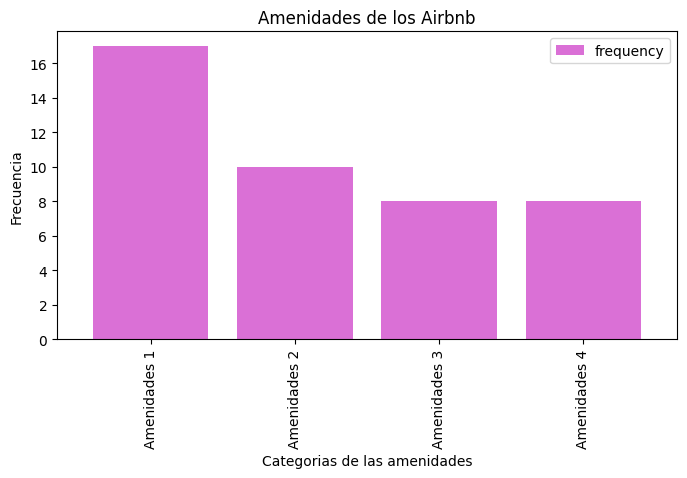

In [136]:
Filtro_index_frequency1.plot(kind = 'bar', width=0.8, figsize=(8,4),color='orchid')
plt.title('Amenidades de los Airbnb')
plt.xlabel('Categorias de las amenidades')
plt.ylabel('Frecuencia')

In [137]:
numcol_clean.dtypes

host_listings_count                             float64
host_total_listings_count                       float64
latitude                                        float64
longitude                                       float64
accommodates                                    float64
bathrooms                                       float64
bedrooms                                        float64
beds                                            float64
price                                           float64
minimum_nights                                  float64
maximum_nights                                    int64
minimum_minimum_nights                          float64
maximum_minimum_nights                          float64
minimum_maximum_nights                            int64
maximum_maximum_nights                          float64
minimum_nights_avg_ntm                          float64
maximum_nights_avg_ntm                          float64
availability_30                                 

<Axes: xlabel='bedrooms', ylabel='price'>

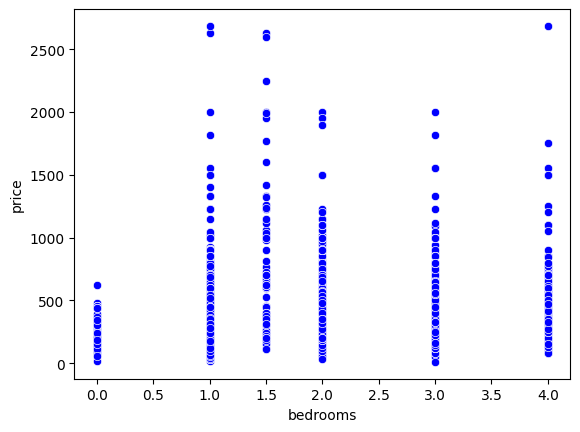

In [138]:
#Imprimimos el scatter plot entre la variable dependiente e independiente
#para observar el comportamiento en su dispersión 
sns.scatterplot(x='bedrooms', y='price', color="blue", data=numcol_clean)


<Axes: xlabel='maximum_nights', ylabel='price'>

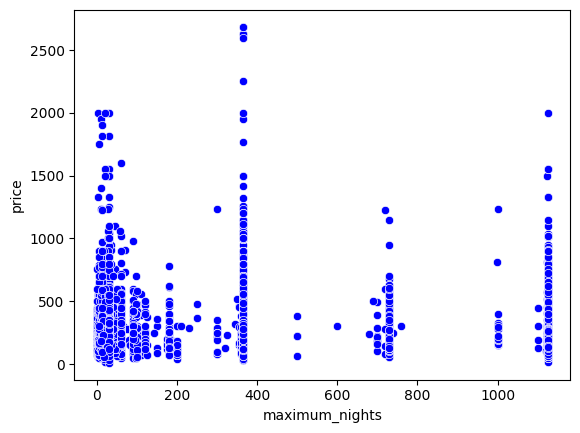

In [139]:
sns.scatterplot(x='maximum_nights', y='price', color="blue", data=numcol_clean)

<Axes: xlabel='review_scores_rating', ylabel='price'>

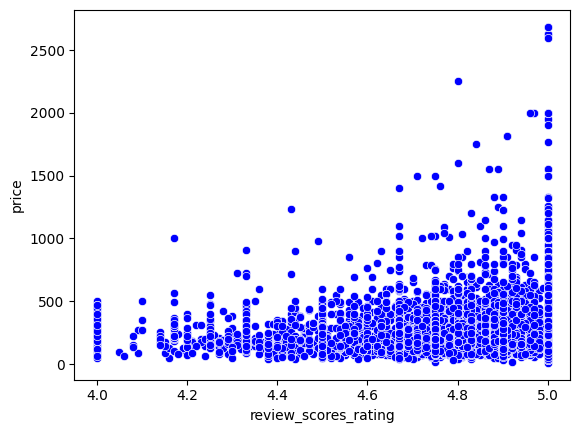

In [158]:
sns.scatterplot(x='review_scores_rating', y='price', color="blue", data=numcol_clean)

In [140]:
#Declaramos las variables dependientes e independientes para la regresión lineal
Vars_Indep= numcol_clean[['bedrooms']]
Var_Dep= numcol_clean['price']

In [141]:
#Declaramos las variables dependientes e independientes para la regresión lineal
Vars_Indep2= numcol_clean[['maximum_nights']]
Var_Dep2= numcol_clean['price']

In [159]:
#Declaramos las variables dependientes e independientes para la regresión lineal
Vars_Indep3= numcol_clean[['review_scores_rating']]
Var_Dep3= numcol_clean['price']

In [164]:
#Se define model como la función de regresión lineal
from sklearn.linear_model import LinearRegression
model= LinearRegression()
model2 = LinearRegression()
model3 = LinearRegression()

In [165]:
#Verificamos la función relacionada al modelo
type(model)
type(model2)
type(model3)

sklearn.linear_model._base.LinearRegression

In [166]:
#Ajustamos el modelo con las variables antes declaradas
model.fit(X=Vars_Indep, y=Var_Dep)

LinearRegression()

In [167]:
#Ajustamos el modelo con las variables antes declaradas
model2.fit(X=Vars_Indep2, y=Var_Dep2)

LinearRegression()

In [168]:
#Ajustamos el modelo con las variables antes declaradas
model3.fit(X=Vars_Indep3, y=Var_Dep3)

LinearRegression()

In [169]:
#Verificamos los coeficientes obtenidos para el modelo ajustado
model.__dict__
model2.__dict__
model3.__dict__

{'fit_intercept': True,
 'copy_X': True,
 'n_jobs': None,
 'positive': False,
 'feature_names_in_': array(['review_scores_rating'], dtype=object),
 'n_features_in_': 1,
 'coef_': array([102.29125328]),
 'rank_': 1,
 'singular_': array([18.86654241]),
 'intercept_': -225.74771429842332}

In [147]:
#Evaluamos la eficiencia del modelo obtenido por medio del coeficiente R Determinación
model.score(Vars_Indep,Var_Dep)

0.07360152875175507

In [148]:
#Evaluamos la eficiencia del modelo obtenido por medio del coeficiente R Determinación
model2.score(Vars_Indep2,Var_Dep2)

0.002037540685043804

In [170]:
model3.score(Vars_Indep3,Var_Dep3)

0.0122883152911899

In [171]:
#Predecimos los valores de total de accidentes a partir de las variables
y_pred= model.predict(X=numcol_clean[['bedrooms']])
y_pred

y_pred2=model2.predict(X=numcol_clean[['maximum_nights']])
y_pred2

y_pred3=model3.predict(X=numcol_clean[['review_scores_rating']])
y_pred3

array([247.86078837, 271.38777662, 268.31903903, ..., 275.47942675,
       275.47942675, 275.47942675])

In [ ]:
#Insertamos la columna de predicciones en el DataFrame
numcol_clean.insert(0, 'Predicciones', y_pred)
#numcol_clean

<Axes: xlabel='bedrooms', ylabel='price'>

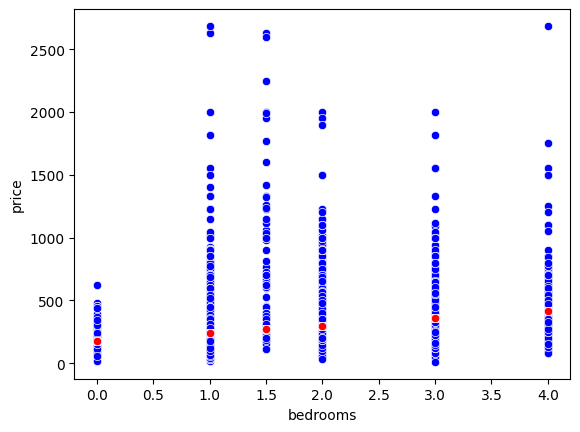

In [173]:
#Visualizamos la gráfica comparativa entre el total real y el total predecido

sns.scatterplot(x='bedrooms', y='price', color="blue", data=numcol_clean)
sns.scatterplot(x='bedrooms', y='Predicciones', color="red", data=numcol_clean)

<Axes: xlabel='maximum_nights', ylabel='price'>

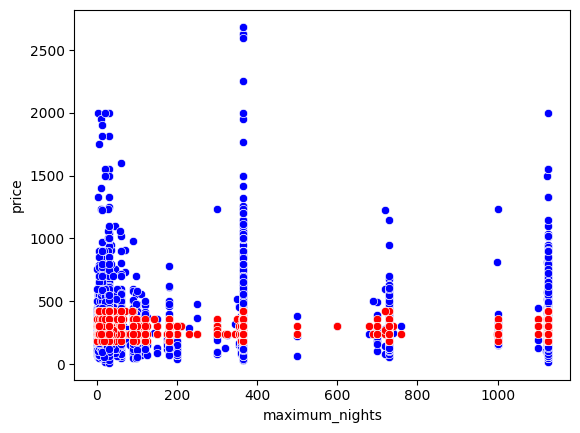

In [153]:
sns.scatterplot(x='maximum_nights', y='price', color="blue", data=numcol_clean)
sns.scatterplot(x='maximum_nights', y='Predicciones', color="red", data=numcol_clean)

<Axes: xlabel='review_scores_rating', ylabel='price'>

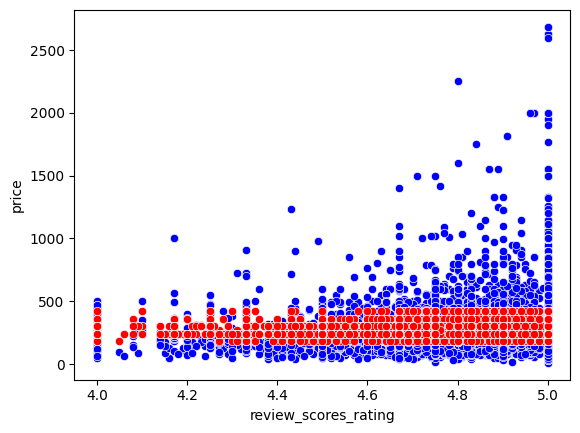

In [174]:
#Visualizamos la gráfica comparativa entre el total real y el total predecido

sns.scatterplot(x='review_scores_rating', y='price', color="blue", data=numcol_clean)
sns.scatterplot(x='review_scores_rating', y='Predicciones', color="red", data=numcol_clean)

In [175]:
#Corroboramos cual es el coeficiente de Determinación de nuestro modelo
coef_Deter=model.score(X=Vars_Indep, y=Var_Dep)
coef_Deter
coef_Deter2=model2.score(X=Vars_Indep2, y=Var_Dep2)
coef_Deter2
coef_Deter3=model3.score(X=Vars_Indep3, y=Var_Dep3)
coef_Deter3

0.0122883152911899

In [176]:
#Corroboramos cual es el coeficiente de Correlación de nuestro modelo
coef_Correl=np.sqrt(coef_Deter)
coef_Correl
coef_Correl2=np.sqrt(coef_Deter2)
coef_Correl2
coef_Correl3=np.sqrt(coef_Deter3)
coef_Correl3

0.1108526738116402

In [ ]:
#Graficamos todas las dispersiones entre todas las variables
#sns.pairplot(df)
#Saltamos esta funcion por el tiempo que tarda en ejecutarse 

In [157]:
#Encontramos todas las correlaciones entre las variables 
Corr_Factors=numcol_clean.corr()
Corr_Factors

,Predicciones,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
Predicciones,1.000000,-0.081789,-0.063259,0.041474,0.064334,0.696452,0.293369,1.000000,0.360958,0.271296,...,-0.012189,0.056893,0.072430,-0.017728,0.031706,-0.112952,0.105265,-0.189517,-0.007464,-0.178052
host_listings_count,-0.081789,1.000000,0.898703,0.002577,0.016331,-0.031806,-0.058682,-0.081789,0.025052,0.023172,...,-0.088517,-0.111326,-0.162119,-0.040322,-0.102516,0.415041,0.158369,0.312288,-0.008502,0.079204
host_total_listings_count,-0.063259,0.898703,1.000000,-0.002961,0.011401,-0.027329,-0.036378,-0.063259,0.023959,0.027227,...,-0.074658,-0.086437,-0.123725,-0.019058,-0.082965,0.329657,0.134766,0.279200,-0.003695,0.060278
latitude,0.041474,0.002577,-0.002961,1.000000,0.044093,0.039945,0.003702,0.041474,0.028987,-0.042322,...,-0.004387,-0.020025,-0.023572,-0.093399,0.003880,0.039759,0.005628,0.010432,0.007808,0.027352
longitude,0.064334,0.016331,0.011401,0.044093,1.000000,0.060947,0.032648,0.064334,0.047625,-0.035274,...,-0.029191,-0.001488,0.000724,0.011054,0.001755,0.044211,-0.013208,0.045262,-0.001409,0.035928
accommodates,0.696452,-0.031806,-0.027329,0.039945,0.060947,1.000000,0.216266,0.696452,0.368861,0.287520,...,-0.041417,0.010153,0.018842,-0.047960,-0.019226,-0.012776,0.181139,-0.170650,0.000253,-0.089014
bathrooms,0.293369,-0.058682,-0.036378,0.003702,0.032648,0.216266,1.000000,0.293369,0.308467,0.299616,...,0.003599,0.031648,0.037133,-0.007242,0.033269,-0.082100,0.017299,-0.052999,-0.002924,-0.114433
bedrooms,1.000000,-0.081789,-0.063259,0.041474,0.064334,0.696452,0.293369,1.000000,0.360958,0.271296,...,-0.012189,0.056893,0.072430,-0.017728,0.031706,-0.112952,0.105265,-0.189517,-0.007464,-0.178052
beds,0.360958,0.025052,0.023959,0.028987,0.047625,0.368861,0.308467,0.360958,1.000000,0.248787,...,-0.036740,-0.017056,-0.018382,-0.069712,-0.025730,0.047411,0.049481,-0.015173,0.002463,-0.056254
price,0.271296,0.023172,0.027227,-0.042322,-0.035274,0.287520,0.299616,0.271296,0.248787,1.000000,...,0.053018,0.071706,0.089384,0.128276,0.052840,-0.008290,0.172855,-0.167724,-0.007453,-0.148405


In [ ]:
#Encontramos el valor absoluto de todas las correlaciones entre las variables 
Corr_Factors1= abs(Corr_Factors)
Corr_Factors1

,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,minimum_nights,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
host_listings_count,1.000000,0.898703,0.002577,0.016331,0.031806,0.058682,0.081789,0.025052,0.023172,0.018923,...,0.088517,0.111326,0.162119,0.040322,0.102516,0.415041,0.158369,0.312288,0.008502,0.079204
host_total_listings_count,0.898703,1.000000,0.002961,0.011401,0.027329,0.036378,0.063259,0.023959,0.027227,0.014163,...,0.074658,0.086437,0.123725,0.019058,0.082965,0.329657,0.134766,0.279200,0.003695,0.060278
latitude,0.002577,0.002961,1.000000,0.044093,0.039945,0.003702,0.041474,0.028987,0.042322,0.027854,...,0.004387,0.020025,0.023572,0.093399,0.003880,0.039759,0.005628,0.010432,0.007808,0.027352
longitude,0.016331,0.011401,0.044093,1.000000,0.060947,0.032648,0.064334,0.047625,0.035274,0.001207,...,0.029191,0.001488,0.000724,0.011054,0.001755,0.044211,0.013208,0.045262,0.001409,0.035928
accommodates,0.031806,0.027329,0.039945,0.060947,1.000000,0.216266,0.696452,0.368861,0.287520,0.004374,...,0.041417,0.010153,0.018842,0.047960,0.019226,0.012776,0.181139,0.170650,0.000253,0.089014
bathrooms,0.058682,0.036378,0.003702,0.032648,0.216266,1.000000,0.293369,0.308467,0.299616,0.027642,...,0.003599,0.031648,0.037133,0.007242,0.033269,0.082100,0.017299,0.052999,0.002924,0.114433
bedrooms,0.081789,0.063259,0.041474,0.064334,0.696452,0.293369,1.000000,0.360958,0.271296,0.056765,...,0.012189,0.056893,0.072430,0.017728,0.031706,0.112952,0.105265,0.189517,0.007464,0.178052
beds,0.025052,0.023959,0.028987,0.047625,0.368861,0.308467,0.360958,1.000000,0.248787,0.001598,...,0.036740,0.017056,0.018382,0.069712,0.025730,0.047411,0.049481,0.015173,0.002463,0.056254
price,0.023172,0.027227,0.042322,0.035274,0.287520,0.299616,0.271296,0.248787,1.000000,0.006961,...,0.053018,0.071706,0.089384,0.128276,0.052840,0.008290,0.172855,0.167724,0.007453,0.148405
minimum_nights,0.018923,0.014163,0.027854,0.001207,0.004374,0.027642,0.056765,0.001598,0.006961,1.000000,...,0.024155,0.049861,0.053029,0.039925,0.056694,0.066453,0.069427,0.129939,0.010692,0.137136


In [ ]:
#Graficamos el mapa de calor de los coeficientes de correlación 
Heat_Map= sns.heatmap(Corr_Factors1, cmap = 'coolwarm')  
Heat_Map

<Axes: >

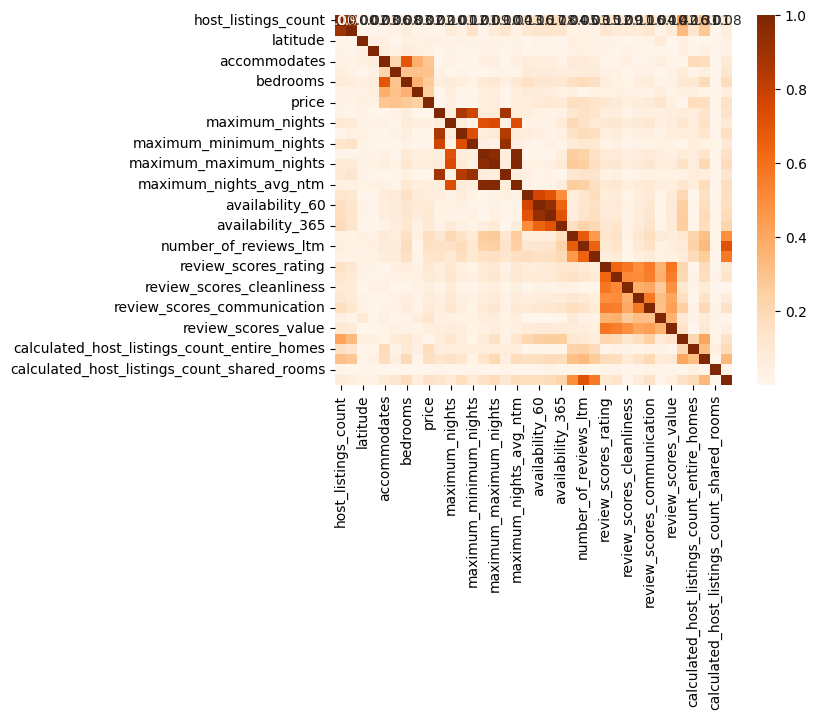

In [ ]:
#Ajustamos el mapa de calor de los coeficientes de correlación 
Heat_Map= sns.heatmap(Corr_Factors1, cmap = 'Oranges', annot=True, fmt=".2f")  
Heat_Map

In [ ]:
# Unimos los otros data frame para ver que esten limpios

dfa_limpio = pd.concat([numcol_clean,numcol,catcol], axis=1)
dfa_limpio.head(3)

,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,...,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_response_time,host_acceptance_rate,property_type,room_type,amenities,host_is_superhost
0,3.0,3.0,52.35931,4.89844,4.0,1.5,2.0,2.0,4.0,21,...,2,1,0,0.22,a few days or more,86%,Entire rental unit,Entire home/apt,"[""Hair dryer"", ""Iron"", ""Microwave"", ""Smoke ala...",f
1,2.0,2.0,52.39185,4.88690,2.9,1.5,1.5,2.0,2.0,30,...,2,0,0,0.72,a few days or more,86%,Boat,Entire home/apt,"[""Patio or balcony"", ""Pets allowed"", ""Stove"", ...",t
2,3.0,3.0,52.35871,4.89616,2.0,1.0,1.0,0.0,3.0,21,...,2,1,0,0.04,a few days or more,86%,Entire rental unit,Entire home/apt,"[""Hair dryer"", ""Iron"", ""High chair"", ""Smoke al...",f


In [ ]:
dfa_limpio.isnull().sum().sum()

0